In [1]:
from importlib import reload
from rlxutils import subplots
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import torch

import omegaconf
from loguru import logger
from omegaconf import DictConfig, OmegaConf
import hydra
from progressbar import progressbar as pbar

from earthtext.datamodules import chipmultilabel
from earthtext.models import osmencoder
from importlib import reload
reload(chipmultilabel)
reload(osmencoder)

from earthtext.osm import multilabel
name_dict = multilabel.kvmerged.inverse_codes

In [2]:
classes_retain = [2, 3, 4, 5, 6, 7, 8, 13, 14, 18,
                  30, 31, 33, 37, 43, 45, 58, 61, 68, 84,
                  87, 93, 96, 97, 98]

print(len(classes_retain))
for c in classes_retain:
    print(c, name_dict[c])

25
2 building=*
3 building=apartments
4 building=house
5 building=industrial
6 building=residential
7 building=school
8 building=warehouse
13 highway=*
14 highway=track
18 landuse=commercial
30 landuse=residential
31 landuse=retail
33 leisure=*
37 leisure=park
43 natural=*
45 natural=bay
58 natural=water
61 parking=*
68 sport=*
84 water=*
87 water=lake
93 waterway=*
96 highway=residential
97 waterway=river
98 waterway=stream


## setup dataloader

In [3]:
conf = OmegaConf.load("../../configs/osmencoder-x.yaml")
conf.dataloader.metadata_file = '/opt/data/california-worldcover-chips/\
california-worldcover-chips-osm-multilabels_mod-prec85pc_emb-v1s2.parquet'
conf.dataloader.embeddings_folder = '/opt/data/california-worldcover-chips/embeddings_v1.0'
conf.model.osm_tags_indexes = classes_retain
dl = hydra.utils.instantiate(conf.dataloader)

2024-05-17 17:10:49.949 | INFO     | earthtext.datamodules.components.chipmultilabel:__init__:93 - checking chip files for train split
100% (58690 of 58690) |##################| Elapsed Time: 0:00:02 Time:  0:00:020000
2024-05-17 17:10:52.793 | INFO     | earthtext.datamodules.components.chipmultilabel:__init__:97 - read train split with 58598 chip files (out of 58690)
2024-05-17 17:10:52.794 | INFO     | earthtext.datamodules.components.chipmultilabel:__init__:102 - max cache size is -1
2024-05-17 17:10:53.169 | INFO     | earthtext.datamodules.components.chipmultilabel:__init__:93 - checking chip files for val split
100% (11841 of 11841) |##################| Elapsed Time: 0:00:00 Time:  0:00:000:00
2024-05-17 17:10:53.735 | INFO     | earthtext.datamodules.components.chipmultilabel:__init__:97 - read val split with 11822 chip files (out of 11841)
2024-05-17 17:10:53.735 | INFO     | earthtext.datamodules.components.chipmultilabel:__init__:102 - max cache size is -1
2024-05-17 17:10:5

## setup model and optimizer

In [4]:
# conf = OmegaConf.load("../../configs/osmencoder-x.yaml")

eps = 1e-5


loss_funcs = {
    'rmse': lambda a,b: torch.sqrt(torch.mean( (a - b)**2 )),
    'mse': lambda a,b: torch.mean( (a - b)**2 ),
    
}

dltrain = dl.train_dataloader()

m = hydra.utils.instantiate(conf.model)

optimizer = torch.optim.Adam(m.parameters(), lr=1e-5)
#optimizer = torch.optim.RMSprop(m.parameters(), lr=1e-5)

loss_fn = loss_funcs[conf.training.loss]

dl.disable_chip_loading()

sum([np.product(p.shape) for p in m.parameters()]), conf.training.epochs

(4237056, 1)

In [6]:
from datetime import datetime
models_folder = "/opt/data/models/"
embeddings_version = conf.dataloader.embeddings_folder.split("/")[-1]
nowstr = datetime.today().strftime("%Y-%m-%d_%H:%M")
model_name = f"osm_emcoder__{embeddings_version}__trainedon_{nowstr}"
model_conf_fname = f"{models_folder}/{model_name}.yaml"
model_ckpt_fname = f"{models_folder}/{model_name}.ckpt"

print(model_name)

osm_emcoder__embeddings_v1.0__trainedon_2024-05-17_17:13


In [7]:
dl.disable_chip_loading()
dltrain = dl.train_dataloader()
print(dltrain.dataset.embeddings_normalization)

mean_stdev_norm


## train loop

In [8]:
optimizer = torch.optim.Adam(m.parameters(), lr=1e-5)

In [9]:
n_epochs = conf.training.epochs
n_epochs = 5

lossh = []
rmseh = []
for epoch in range(n_epochs):
    for step, batch in enumerate(dltrain):
        # extract data from batch
        t = batch['embedding']

        # run model
        o = m(batch)

        # compute losses (complex mse or rmse)
        loss_base = loss_fn(t,o)
        loss_reg = torch.sum(torch.stack([(p.abs().mean()) for p in m.parameters()]))

        rmse = loss_funcs['rmse'](t,o)        
        
        #loss_variance = torch.sqrt(torch.mean((t.std(axis=0) - o.std(axis=0))**2))
        output_stdev = (o.std(axis=0)+1e-5).mean()
        loss = loss_base + 10*loss_reg
        
        # backpropage and sigmoidupdate
        loss.backward()
        optimizer.step()
        
        # cosmetics
        lossn = loss.detach().cpu().numpy()
        rmsen = rmse.detach().cpu().numpy()
        lossh.append(lossn)
        rmseh.append(rmsen)
        psummary = np.mean([(p.abs().mean().detach().cpu().numpy()) for p in m.parameters()])    
        lossm = np.mean(lossh[-500:])
        rmsem = np.mean(rmseh[-500:])
        print(f"epoch {epoch:3} step {step:3d} loss {lossm:.5f} rmse {rmsem:.5f} params {loss_reg:.7f} output_stdev {output_stdev.detach().numpy():.5f}", end="\r")

        OmegaConf.save(conf, model_conf_fname)
        torch.save(m.state_dict(), model_ckpt_fname)
        
        #if loss < 0.5:
        #    print ("low loss!!")
        #    break
    #print()

In [10]:
# save model
from datetime import datetime
models_folder = "/opt/data/models/"
embeddings_version = conf.dataloader.embeddings_folder.split("/")[-1]
nowstr = datetime.today().strftime("%Y-%m-%d_%H:%M")
model_name = f"osm_emcoder__{embeddings_version}__trainedon_{nowstr}"
model_conf_fname = f"{models_folder}/{model_name}.yaml"
model_ckpt_fname = f"{models_folder}/{model_name}.ckpt"
print(model_ckpt_fname)

/opt/data/models//osm_emcoder__embeddings_v1.0__trainedon_2024-05-17_17:33.ckpt


In [11]:
OmegaConf.save(conf, model_conf_fname)
torch.save(m.state_dict(), model_ckpt_fname)

print(model_ckpt_fname)

/opt/data/models//osm_emcoder__embeddings_v1.0__trainedon_2024-05-17_17:33.ckpt


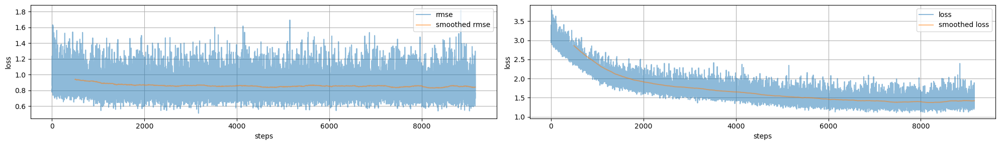

In [12]:
def ploth(h, name='loss', ylim=None, ax=None):
    lossp = pd.DataFrame(h, columns=[name])
    lossp[f'smoothed {name}'] = lossp[name].rolling(500).mean()
    lossp.plot(alpha=.5, ax=ax)
    plt.grid(); plt.xlabel("steps"); plt.ylabel("loss")
    if ylim is not None:
        plt.ylim(*ylim)
        
for ax,i in subplots(2, usizex=10):
    if i==0: ploth(np.r_[rmseh], name='rmse', ax=ax)#, ylim=(-.01,15))
    if i==1: ploth(lossh, name='loss', ax=ax,)# ylim=(0.3,1.))

In [13]:
o[-5:]

tensor([[ 0.1079, -0.0588,  0.3066,  ...,  0.3171, -0.0687, -0.2328],
        [ 0.0735, -0.2125,  0.4817,  ...,  0.3213, -0.0258, -0.4710],
        [-0.2912,  0.3449, -0.6841,  ..., -0.0598, -0.1207,  0.6669],
        [-0.5329,  0.3329, -0.8197,  ..., -0.1902, -0.1635,  0.7510],
        [-0.2990, -0.4631,  0.3396,  ..., -0.6167,  0.1323, -0.8297]],
       grad_fn=<SliceBackward0>)

In [14]:
t[-5:]

tensor([[ 0.3941, -0.3174,  0.9519,  ...,  0.6414, -0.5201, -0.7599],
        [-0.1797, -0.4461, -0.4305,  ...,  0.7010,  0.7538, -0.7737],
        [-0.3668,  0.0308, -1.7634,  ..., -0.5270, -0.0447,  1.4419],
        [ 0.1725,  0.0186,  0.3865,  ...,  0.8379,  0.0348, -0.4132],
        [-1.2638, -0.4162, -0.3392,  ..., -1.1990, -0.2988,  0.8143]])

## visualize targets vs predictions on random chips

In [15]:
dl.enable_chip_loading()

In [16]:
# b = next(iter(dl.train_dataloader()))
b = next(iter(dl.test_dataloader()))
b.keys()

dict_keys(['multilabel', 'chip', 'embedding', 'osm_strlabels', 'osm_ohearea', 'osm_ohecount', 'osm_ohelength'])

In [17]:
len(b['chip'])

32

In [18]:
# tr_targets = b['embedding'].numpy()[:16]
# tr_predictions = m(b).detach().numpy()[:16]
test_targets = b['embedding'].numpy()[:16]
test_predictions = m(b).detach().numpy()[:16]

In [19]:
def plot_chip(batch, idx):
    b = batch
    c = b['chip'][idx][:3].detach().numpy()
    c = np.transpose(c, [1,2,0]).astype(float)
    _,vmax = np.percentile(c, [5,99])
    c /= vmax
    c[c>1]=1
    plt.axis('off')
    plt.imshow(c)

    n_osmobjects = b['osm_ohecount'][idx].numpy().sum()
    total_osmarea = b['osm_ohearea'][idx].numpy().sum()
    total_osmlength = b['osm_ohelength'][idx].numpy().sum()

    plt.title(f"chip {idx}\nosm count {n_osmobjects}\nosm area {total_osmarea:.2f}\nosm length {total_osmlength:.2f}")

In [20]:
# conf.training.loss, len(tr_targets)
conf.training.loss, len(test_targets)

('rmse', 16)

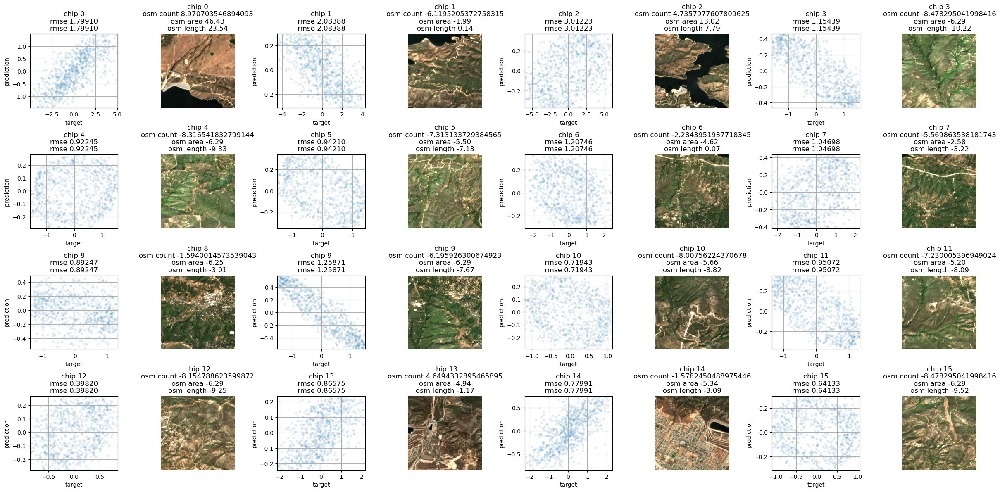

In [21]:
for ax,i in subplots(len(test_targets)*2, n_cols=8):
    idx = i//2
    t = test_targets[idx]
    p = test_predictions[idx]
    if i%2==0:
        plt.scatter(t, p, alpha=.1, s=10)
        plt.grid()
        plt.xlabel("target")
        plt.ylabel("prediction")
        rmse = np.sqrt(np.mean ( (t-p)**2 ))
        logr = loss_funcs[conf.training.loss](torch.tensor(t),torch.tensor(p))
        plt.title(f"chip {idx}\nrmse {rmse:.5f}\n{conf.training.loss} {logr:.5f}")
        ta,tb = np.percentile(t, [1,99])
        pa,pb = np.percentile(p, [1,99])
        plt.xlim(ta, tb)
        plt.ylim(pa, pb)
    else:
        plot_chip(b, idx)


## measure loss on full train,val,test datasets

In [22]:
def get_targets_and_predictions(dataloader):
    targets = []
    predictions = []
    inputs = []
    for batch in pbar(dataloader):
        t = batch['embedding']
        o = m(batch)
        x = m.make_input(batch)
    
        for ti in t.detach().numpy():
            targets.append(ti)
    
        for oi in o.detach().numpy():
            predictions.append(oi)

        for xi in x.detach().numpy():
            inputs.append(xi)
        
    targets = np.r_[targets]
    predictions = np.r_[predictions]
    inputs = np.r_[inputs]
    return targets, predictions, inputs

In [23]:
dl.disable_chip_loading()
tr_targets, tr_predictions, tr_inputs = get_targets_and_predictions(dl.train_dataloader())

100% (1832 of 1832) |####################| Elapsed Time: 0:00:22 Time:  0:00:220001


In [47]:
# dl.disable_chip_loading()
# dataloader = dl.test_dataloader()

In [24]:
ts_targets, ts_predictions, ts_inputs = get_targets_and_predictions(dl.test_dataloader())
val_targets, val_predictions, val_inputs = get_targets_and_predictions(dl.val_dataloader())

100% (409 of 409) |######################| Elapsed Time: 0:00:06 Time:  0:00:060000
100% (370 of 370) |######################| Elapsed Time: 0:00:05 Time:  0:00:050000


In [25]:
regr_to_mean_tr = tr_targets.mean(axis=0)
v = loss_funcs['rmse']
print (f"rmse regr to mean {v(torch.tensor(tr_targets), torch.tensor(regr_to_mean_tr)):.5f}")
print (f"rmse train        {v(torch.tensor(tr_targets), torch.tensor(tr_predictions)):.5f}")
print (f"rmse test         {v(torch.tensor(ts_targets), torch.tensor(ts_predictions)):.5f}")
print (f"rmse val          {v(torch.tensor(val_targets), torch.tensor(val_predictions)):.5f}")

rmse regr to mean 1.00001
rmse train        0.86581
rmse test         0.95052
rmse val          0.95294


## compare random pairs

In [26]:
def similarity(a,b):
    a = a / np.linalg.norm(a)
    b = b / np.linalg.norm(b)
    return a.dot(b) 

In [27]:
i1,i2 = np.random.permutation(len(tr_targets))[:2]

100% (10000 of 10000) |##################| Elapsed Time: 0:00:13 Time:  0:00:130001
100% (10000 of 10000) |##################| Elapsed Time: 0:00:02 Time:  0:00:020000
100% (10000 of 10000) |##################| Elapsed Time: 0:00:01 Time:  0:00:010000


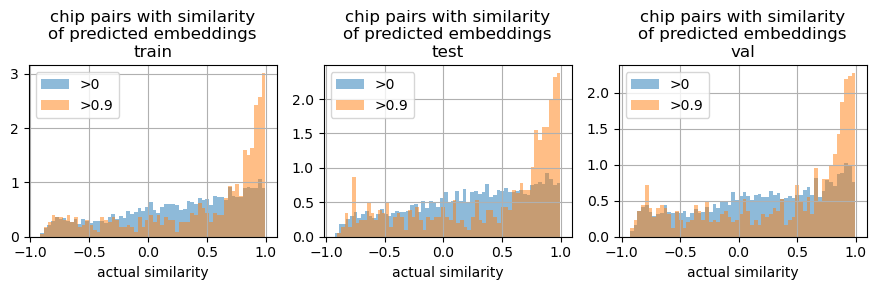

In [28]:
targets, predictions = tr_targets, tr_predictions

for ax, i in subplots(3):
    if i==0: targets, predictions, split_name = tr_targets, tr_predictions, "train"
    if i==1: targets, predictions, split_name = ts_targets, ts_predictions, "test" 
    if i==2: targets, predictions, split_name = val_targets, val_predictions, "val"


    r = []
    for _ in pbar(range(10000)):
        i1,i2 = np.random.permutation(len(targets))[:2]
        simt = similarity(targets[i1], targets[i2])
        simp = similarity(targets[i1], predictions[i2])
        r.append([simt, simp])
    r = np.r_[r]
    r = pd.DataFrame(r, columns=['sim', 'sim_osmencoder'])
    
    thr = 0.9
    for thr in [0, 0.9]:
        rr = r[r['sim_osmencoder']>thr]
        plt.hist(rr['sim'], bins=60, density=True, alpha=.5, label=f">{thr}");
    plt.title(f"chip pairs with similarity\nof predicted embeddings\n{split_name}")
    plt.xlabel("actual similarity")
    plt.grid()
    plt.legend();

Text(0, 0.5, 'a-similarity')

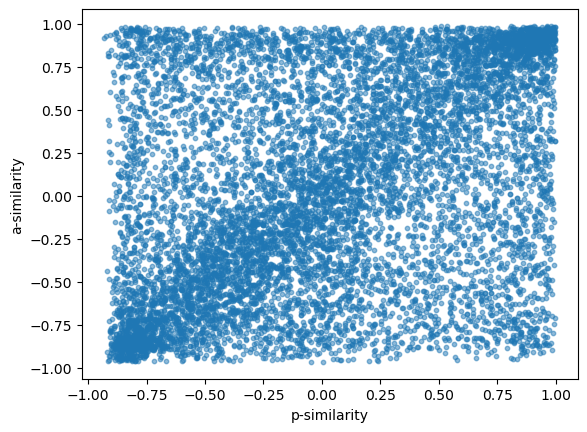

In [29]:
plt.scatter(r['sim'], r['sim_osmencoder'], s=10, alpha=.5)
plt.xlabel("p-similarity")
plt.ylabel("a-similarity")

Text(0, 0.5, 'a-similarity')

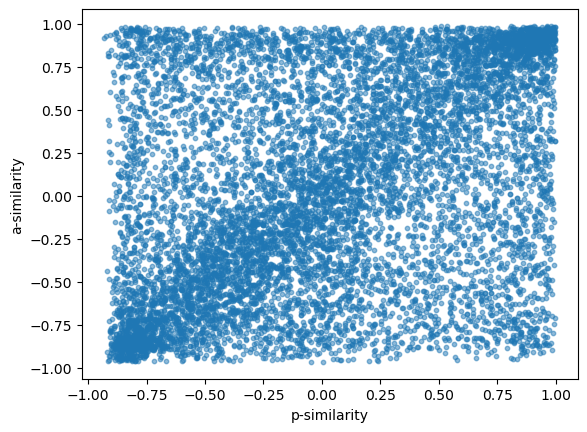

In [30]:
plt.scatter(r['sim'], r['sim_osmencoder'], s=10, alpha=.5)
plt.xlabel("p-similarity")
plt.ylabel("a-similarity")

## searching

In [31]:
#conf = OmegaConf.load("../../configs/osmencoder-abs-logrsme-1epoch.yaml")
conf = OmegaConf.load("../../configs/osmencoder-x.yaml")
conf.dataloader.metadata_file = '/opt/data/california-worldcover-chips/\
california-worldcover-chips-osm-multilabels_mod-prec85pc_emb-v1s2.parquet'
conf.dataloader.embeddings_folder = '/opt/data/california-worldcover-chips/embeddings_v1.0'
conf.model.osm_tags_indexes = classes_retain

dl = hydra.utils.instantiate(conf.dataloader)

2024-05-17 17:37:45.710 | INFO     | earthtext.datamodules.components.chipmultilabel:__init__:93 - checking chip files for train split
100% (58690 of 58690) |##################| Elapsed Time: 0:00:03 Time:  0:00:030000
2024-05-17 17:37:48.751 | INFO     | earthtext.datamodules.components.chipmultilabel:__init__:97 - read train split with 58598 chip files (out of 58690)
2024-05-17 17:37:48.751 | INFO     | earthtext.datamodules.components.chipmultilabel:__init__:102 - max cache size is -1
2024-05-17 17:37:49.135 | INFO     | earthtext.datamodules.components.chipmultilabel:__init__:93 - checking chip files for val split
100% (11841 of 11841) |##################| Elapsed Time: 0:00:00 Time:  0:00:000000
2024-05-17 17:37:49.748 | INFO     | earthtext.datamodules.components.chipmultilabel:__init__:97 - read val split with 11822 chip files (out of 11841)
2024-05-17 17:37:49.748 | INFO     | earthtext.datamodules.components.chipmultilabel:__init__:102 - max cache size is -1
2024-05-17 17:37:5

In [32]:
def get_top10_sim(vectorbase, query):
    ntargets = (vectorbase.T / np.linalg.norm(vectorbase,axis=1)).T
    nquery   = query / np.linalg.norm(query)
    sims = ntargets.dot(nquery)
    top10idxs = np.argsort(sims)[-10:]
    return top10idxs

In [33]:
# load all data from selected split

dl.disable_chip_loading()
dataloader = dl.test_dataloader()
targets, predictions, inputs = get_targets_and_predictions(dataloader)


100% (409 of 409) |######################| Elapsed Time: 0:00:05 Time:  0:00:050000


In [34]:
def similarity(t1,t2):
    
    t1 = t1 / np.linalg.norm(t1)
    t2 = t2 / np.linalg.norm(t2)
    return t1.dot(t2) 

def random_query():
    # select a random chip
    ds = dataloader.dataset
    
    idx = np.random.randint(len(ds))
    
    ds.cache = {}
    ds.disable_chip_loading = False
    cquery = ds[idx]
    
    cpred_emebddings = predictions[idx]
    ctrue_embeddings = targets[idx]
    
    # search top 10 similar
    idxs = get_top10_sim(targets, cpred_emebddings)
    chips = [ds[i] for i in idxs]
    
    # sanity check
    np.allclose(ctrue_embeddings, cquery['embedding'])
    
    for ax,i in subplots(len(chips)):
        if i==0:
            c = cquery
            s = similarity(cpred_emebddings, c['embedding']) 
            title = f"query chip\nsimilarity embeddings\npred vs true\n{s:4f}"
        else:
            c = chips[i-1]
            s = similarity(cpred_emebddings, c['embedding']) 
            title = f"sim to query predicted\nembedding {s:.4f}"
            
        cimg = c['chip'][:3]
        cimg = np.transpose(cimg, [1,2,0]) 
        cimg = cimg / 2000
        cimg[cimg>1] = 1
        plt.imshow(cimg)
        plt.title(title)
        plt.axis("off")

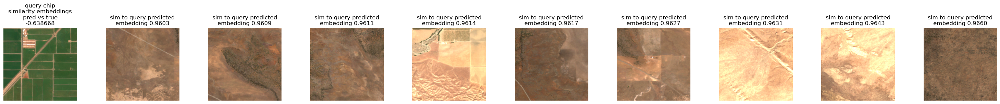

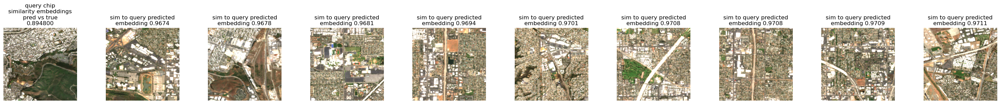

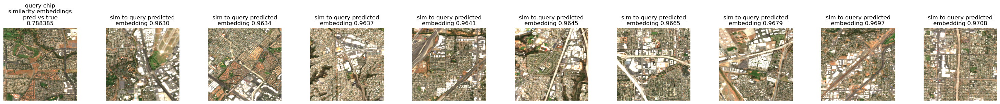

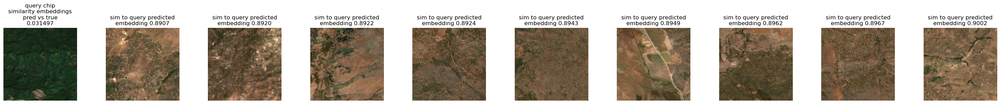

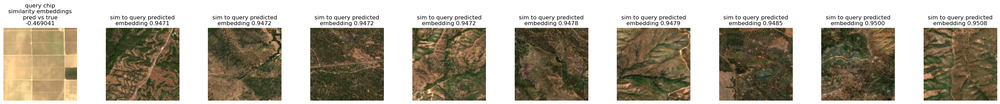

...

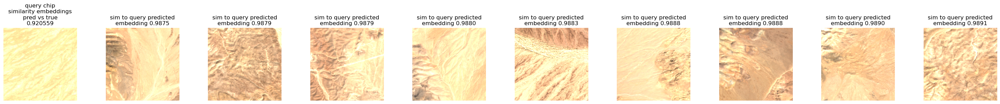

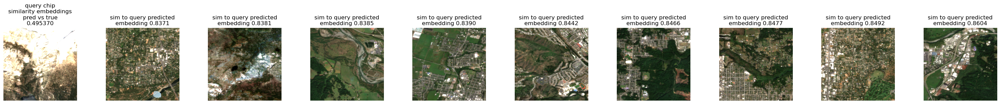

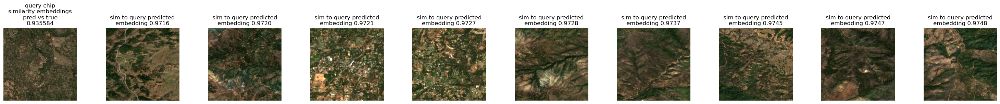

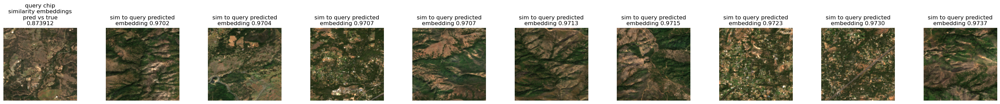

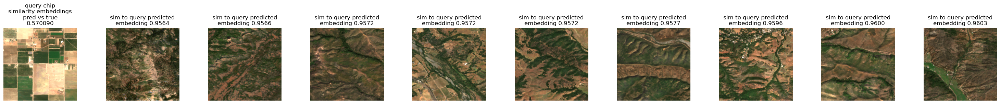

In [35]:
for _ in range(20):
    random_query()

## targets vs other targets 

In [36]:
def plot_target_pairs(targets):
    for ax,i in subplots(len(targets)//2 * 3, n_cols=9):
        idx1 = i//3
        idx2 = len(targets)//2+i//3
    
        if i%3==0:
            t1 = targets[idx1]
            t2 = targets[idx2]
            a1,b1 = np.percentile(t1, [1,99])
            a2,b2 = np.percentile(t2, [1,99])
            plt.scatter(t1, t2, alpha=.2)
            t1 = t1 / np.linalg.norm(t1)
            t2 = t2 / np.linalg.norm(t2)
            simmilarity = t1.dot(t2) 
            plt.title(f"simm {simmilarity:.4f}")
            plt.xlim(a1,b1)
            plt.ylim(a2,b2)
            plt.grid()
            plt.xlabel(f"clayv2 embeddings for chip {idx1}")
            plt.ylabel(f"clayv2 embeddings for chip {idx2}")
        elif i%3==1:
            plot_chip(b, idx1)
        else:
            plot_chip(b, idx2)

In [37]:
from earthtext.datamodules.components import chipmultilabel

In [38]:
dl.enable_chip_loading()
traindl = dl.train_dataloader()
traindl.dataset.substract_embeddings_mean = False
b = next(iter(traindl))

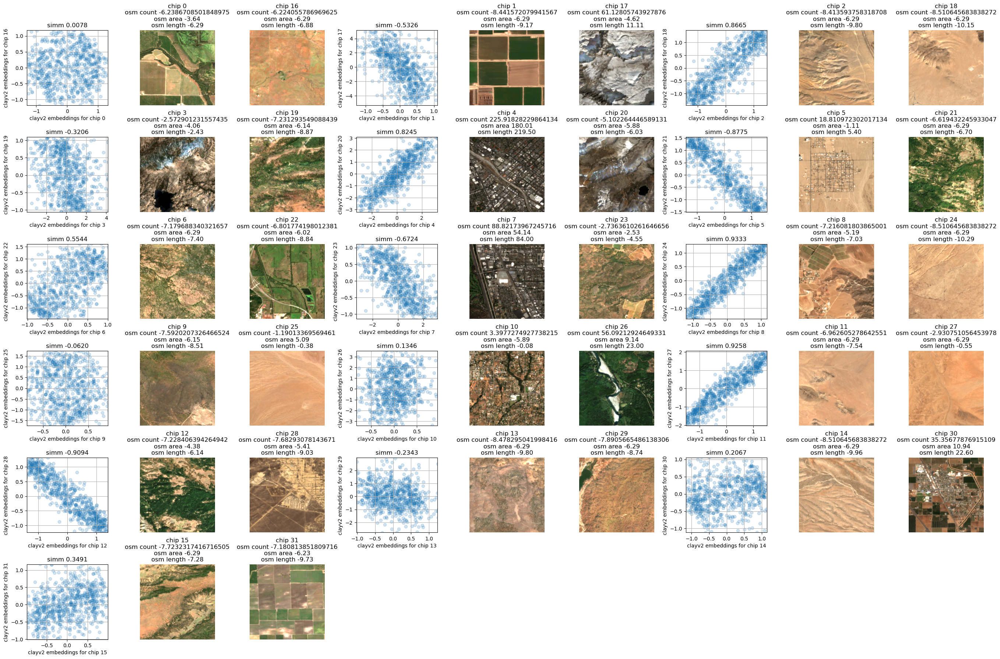

In [39]:
tr_targets = b['embedding'].numpy() 

plot_target_pairs(tr_targets)

In [97]:
embeddings_mean = chipmultilabel.embeddings_mean
def signed_meanembedding_substraction(t):
    return torch.sign(t) * torch.abs(t - embeddings_mean)    

NameError: name 'norm_embeddings' is not defined

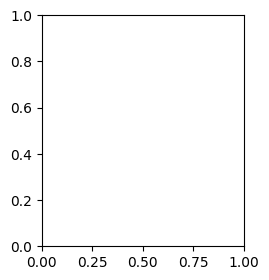

In [98]:
for ax,i in subplots(4):
    t = b['embedding'].numpy() 
    #tm = b['embedding'].numpy() - chipmultilabel.embeddings_mean
    tm = norm_embeddings(b['embedding']).numpy()
    i1, i2 = 1,9
    if i==0: 
        plt.scatter(t[i1], t[i2], alpha=.5, s=10)
        plt.title(f"chips {i1} vs {i2}\n original embeddings")
    if i==1: 
        plt.scatter(tm[i1], tm[i2], alpha=.5, s=10)
        plt.title(f"chips {i1} vs {i2}\nmean substracted embeddings")
    if i==2:
        plt.scatter(t[i1], tm[i1], alpha=.5, s=10)
        plt.title(f"chip {i1} original vs substracted")
        plt.xlim(-0.02, 0.02); plt.ylim(-0.02, 0.02)
    if i==3:
        plt.scatter(t[i2], tm[i2], alpha=.5, s=10)
        plt.title(f"chip {i2} original vs substracted")
        plt.xlim(-0.02, 0.02); plt.ylim(-0.02, 0.02)
    
    plt.grid();
    

In [38]:
(np.sign(t[i1]) == np.sign(t[i2]) ).mean(), (np.sign(tm[i1]) == np.sign(tm[i2]) ).mean()

(0.87890625, 0.87890625)

(-1.0, 100.0)

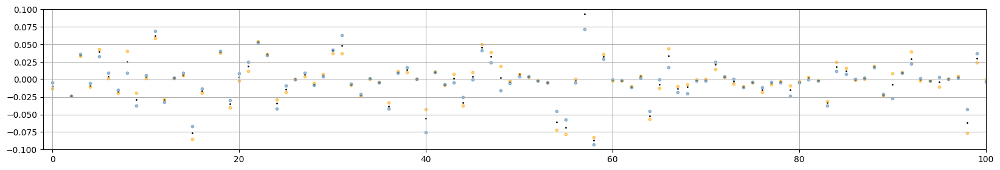

In [33]:
n = len(chipmultilabel.embeddings_mean)
plt.figure(figsize=(20,3))
plt.scatter(range(n), chipmultilabel.embeddings_mean, s=1, c='black')
plt.scatter(range(n), t[i1], alpha=.5, s=10, c='orange')
plt.scatter(range(n), t[i2], alpha=.5, s=10, c='steelblue')
plt.grid();
plt.ylim(-0.1, 0.1)
plt.xlim(-1,100)

In [207]:
conf = OmegaConf.load("../../configs/osmencoder-x.yaml")
dl = hydra.utils.instantiate(conf.dataloader)

2024-04-18 17:17:38.488 | INFO     | earthtext.datamodules.components.chipmultilabel:__init__:1041 - checking chip files for train split
100% (60396 of 60396) |##################| Elapsed Time: 0:00:03 Time:  0:00:030000
2024-04-18 17:17:41.596 | INFO     | earthtext.datamodules.components.chipmultilabel:__init__:1045 - read train split with 60295 chip files (out of 60396)
2024-04-18 17:17:41.644 | INFO     | earthtext.datamodules.components.chipmultilabel:__init__:1049 - limitting to 100 items, randomly selected
2024-04-18 17:17:41.650 | INFO     | earthtext.datamodules.components.chipmultilabel:__init__:1050 - max cache size is -1
2024-04-18 17:17:42.371 | INFO     | earthtext.datamodules.components.chipmultilabel:__init__:1041 - checking chip files for val split
100% (12304 of 12304) |##################| Elapsed Time: 0:00:00 Time:  0:00:000000
2024-04-18 17:17:43.011 | INFO     | earthtext.datamodules.components.chipmultilabel:__init__:1045 - read val split with 12288 chip files (o

In [208]:
dl.enable_chip_loading()
traindl = dl.train_dataloader()
traindl.dataset.substract_embeddings_mean = False
b = next(iter(traindl))

In [209]:
b.keys()

dict_keys(['multilabel', 'chip', 'embedding', 'osm_strlabels', 'osm_ohearea', 'osm_ohecount', 'osm_ohelength'])

In [211]:
ztr_targets = b['embedding'].detach().numpy()
ztr_targets.shape

(32, 768)

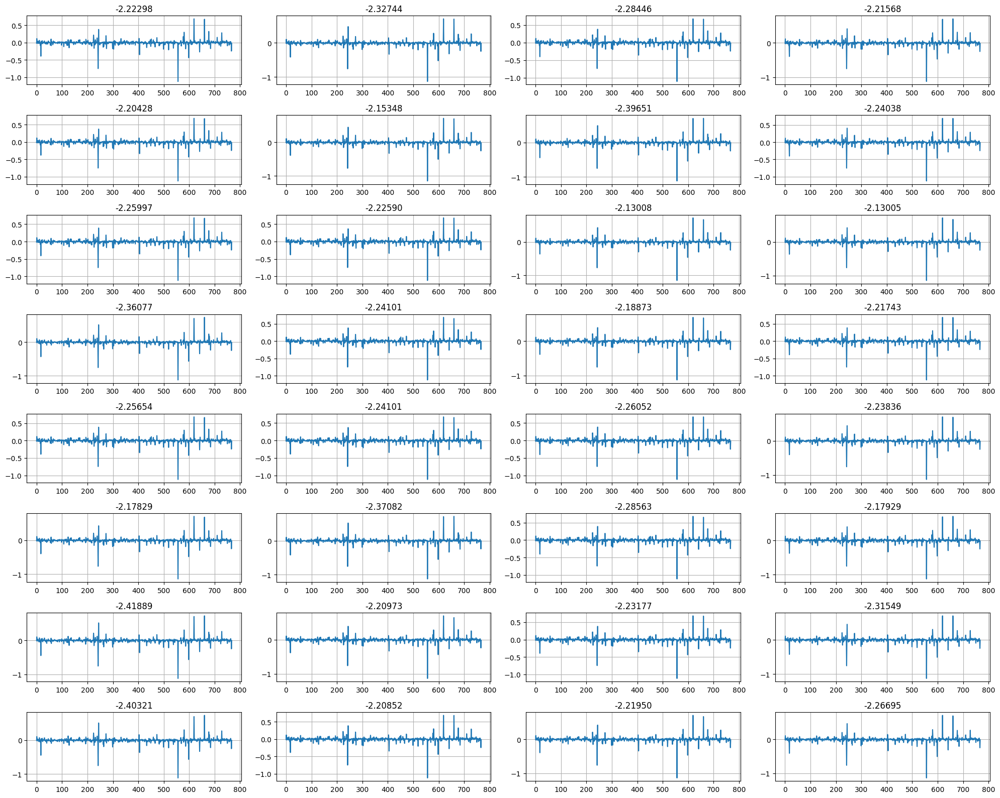

In [212]:
for ax, i in subplots(len(ztr_targets), usizex=5, usizey=2, n_cols=4):
    t = ztr_targets[i]
    plt.plot(t)
    plt.grid()
    plt.title(f"{sum(t):.5f}")

In [213]:
mtr_targets = ztr_targets - chipmultilabel.embeddings_mean

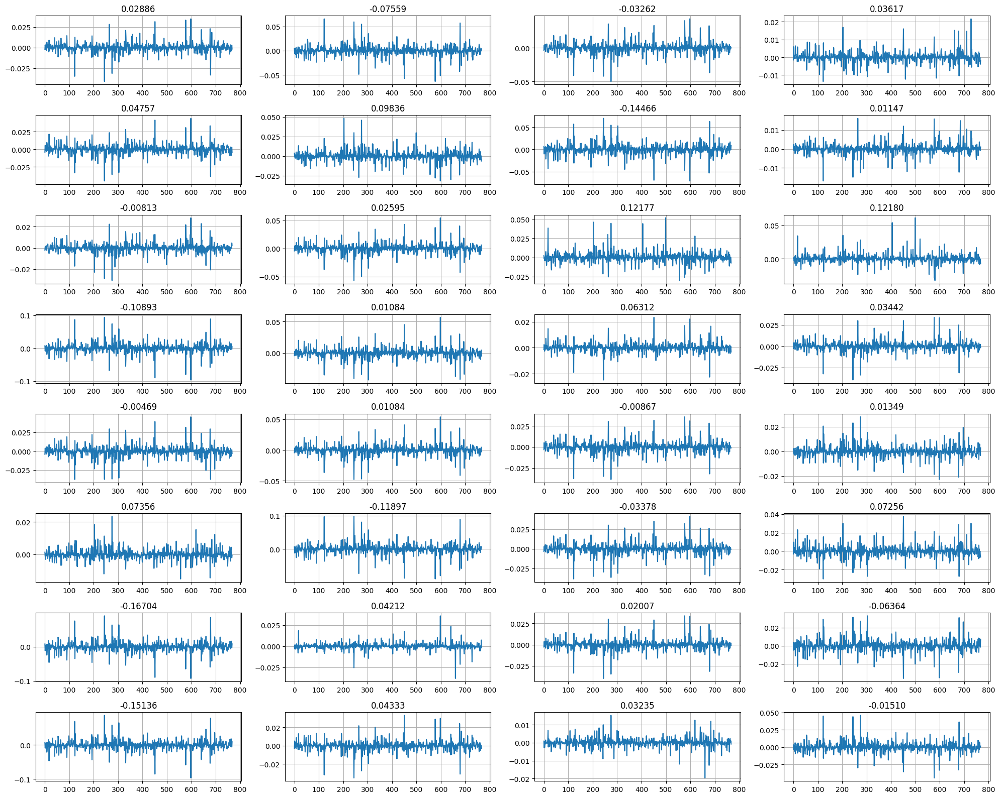

In [214]:
for ax, i in subplots(len(mtr_targets), usizex=5, usizey=2, n_cols=4):
    t = mtr_targets[i]
    plt.plot(t)
    plt.grid()
    plt.title(f"{sum(t):.5f}")